In [1]:
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Video, HTML

%matplotlib inline

To build the slides from this notebook:

```
> jupyter nbconvert slides.ipynb --to slides --post serve
```

# Collaborative Development of Python Tools for Field-Aligned Codes
## ISSI Bern Team on Interrogating Field-Aligned Solar Flare Models
## 27--31 January 2020
### Will Barnes (NRC/NRL)

# Configuring and Analyzing Field-Aligned Results

* Similar setup and post-processing for most models
    * Run field-aligned codes for varying $L$, heating, $g(s)$, etc.
    * Results are 2D, i.e. function of $s$ and $t$
    * Plot $T$, $n$, $v$, etc. as function of $s$ for snapshots in $t$
    * Time-distance plots
    * Spatially-averge, plot as function of $t$

* Differences
  * Not all quantities common to all codes (e.g. HYDRAD computes electron and ion temperature, RADYN does not)
  * Configuration parameters tailored heavily to each code

# Current State

* Multiple tools in multiple languages (mostly IDL, some Python, others???) with lots of overlap
  * E.g. Will, Jeff, Steve, Craig all have their own tools for configuring, parsing, plotting HYDRAD
* Often not a lot of thought goes into post-processing scripts; end up being messy, kludged together
* Lots of time reinventing the wheel
* Little code re-use = a lot of maintenance, things break
* Difficult to compare results

# Proposed Solution

* **Common API** for post-processing *across* field-aligned codes (or at least within codes)
* General enough to suit all cases, useful enough to justify effort
* Underlying logic separated from user-interface
* Code **collaboratively** and **openly** developed (preferably in Python, other suggestions?)
* Documentation
* Testing

* Benefits everyone, especially new users!
* Ease of configuration, post processing means more users of these codes!
* More users = more papers on field-aligned modeling = more citations
* Reduce boilerplate code needed for every project
* Thorough, maintained documentation reduces likelihood of misuse/abuse

# Demo of `hydrad_tools`

* Code: [github.com/rice-solar-physics/hydrad_tools](https://github.com/rice-solar-physics/hydrad_tools/)
* Docs: [rice-solar-physics.github.io/hydrad_tools](https://rice-solar-physics.github.io/hydrad_tools/)

## Configuring a Simulation

In [47]:
from hydrad_tools.configure import Configure

In [48]:
config = Configure.load_config('/Users/willbarnes/Documents/work/codes/hydrad_tools/defaults.asdf')

In [49]:
config.keys()

dict_keys(['asdf_library', 'history', 'general', 'grid', 'heating', 'initial_conditions', 'radiation', 'solver'])

In [50]:
config['general']

{'footpoint_height': <Quantity 5.e+08 cm>,
 'loop_inclination': <Quantity 0. deg>,
 'force_single_fluid': False,
 'heat_flux_timestep_limit': <Quantity 1.e-10 s>,
 'logging_frequency': 1000,
 'minimum_collisional_coupling_timescale': <Quantity 0.01 s>,
 'output_interval': <Quantity 1. s>,
 'heat_flux_limiting_coefficient': 0.167,
 'use_kinetic_model': False,
 'write_file_equation_terms': False,
 'write_file_hydrogen_level_populations': False,
 'write_file_ion_populations': False,
 'write_file_physical': True,
 'write_file_timescales': False}

In [51]:
import astropy.units as u

In [52]:
config['general']['total_time'] = 7.2e3 * u.s
config['general']['loop_length'] = 9e9 * u.cm
# Equivalently
config['general']['total_time'] = 2 * u.h
config['general']['loop_length'] = 90 * u.Mm

In [53]:
config['initial_conditions']['heating_location'] = 45 * u.Mm
config['initial_conditions']['heating_scale_height'] = 1e300 * u.cm

In [54]:
config['grid']['maximum_refinement_level'] = 5
config['solver']['cutoff_temperature_fraction'] = 0.2

In [55]:
# Nanoflare-type heating
config['heating']['events'] = [
    {'time_start': 0*u.s,
     'rise_duration': 100*u.s,
     'decay_duration':100*u.s,
     'total_duration':200*u.s,
     'location':45*u.Mm,
     'scale_height':1e300*u.cm,
     'rate':0.1*u.erg/u.s/(u.cm**3),}
]

In [56]:
c = Configure(config)

In [57]:
%%bash
rm -rf /Users/willbarnes/Desktop/issi_test_demo

In [58]:
c.setup_simulation(
    '/Users/willbarnes/Desktop/',
    base_path='/Users/willbarnes/Documents/work/codes/HYDRAD/',
    name='issi_test_demo',
    verbose=False
)

In [59]:
!ls /Users/willbarnes/Desktop/issi_test_demo/

Forward_Model            Initial_Conditions       Resources
HYDRAD                   Initial_Conditions.exe   Results
HYDRAD.exe               Kinetic_Model            Visualisation
HYDRAD_GUI               LICENSE                  hydrad_tools_config.asdf
HYDRAD_GUI.jar           README.md
Heating_Model            Radiation_Model


In [60]:
!ls /Users/willbarnes/Desktop/issi_test_demo/Initial_Conditions/profiles/

initial.amr         initial.amr.phy     profiles.txt
initial.amr.gravity initial.amr.sol


In [61]:
!head -n 30 /Users/willbarnes/Desktop/issi_test_demo/hydrad_tools_config.asdf

#ASDF 1.0.0
#ASDF_STANDARD 1.4.0
%YAML 1.1
%TAG ! tag:stsci.edu:asdf/
--- !core/asdf-1.1.0
asdf_library: !core/software-1.0.0 {author: Space Telescope Science Institute, homepage: 'http://github.com/spacetelescope/asdf',
  name: asdf, version: 2.5.1}
history:
  extensions:
  - !core/extension_metadata-1.0.0
    extension_class: asdf.extension.BuiltinExtension
    software: {name: asdf, version: 2.5.1}
  - !core/extension_metadata-1.0.0
    extension_class: astropy.io.misc.asdf.extension.AstropyAsdfExtension
    software: {name: astropy, version: '4.0'}
general:
  footpoint_height: !unit/quantity-1.1.0 {unit: !unit/unit-1.0.0 cm, value: 500000000.0}
  force_single_fluid: false
  heat_flux_limiting_coefficient: 0.167
  heat_flux_timestep_limit: !unit/quantity-1.1.0 {unit: !unit/unit-1.0.0 s, value: 1.0e-10}
  logging_frequency: 1000
  loop_inclination: !unit/quantity-1.1.0 {unit: !unit/unit-1.0.0 deg, value: 0.0}
  loop_length: !unit/quantity-1.1.0 {unit: !unit/unit-1.0.0 Mm, value: 90.0

What if I pass a parameter with the wrong units?

In [62]:
config['general']['total_time'] = 2 * u.kg

In [63]:
Configure(config).setup_simulation(
    '/Users/willbarnes/Desktop/',
    base_path='/Users/willbarnes/Documents/work/codes/HYDRAD/',
    verbose=False
)

UnitConversionError: 'kg' (mass) and 's' (time) are not convertible

Or what if I don't include a required parameter?

In [64]:
del config['general']['total_time']

In [65]:
Configure(config).setup_simulation(
    '/Users/willbarnes/Desktop/',
    base_path='/Users/willbarnes/Documents/work/codes/HYDRAD/',
    verbose=False
)

MissingParameter: Parameter required for configuration

It is easy to configure many simulations for different parameters!

In [66]:
lengths = [20, 50, 90, 180]*u.Mm

In [67]:
!rm -rf /Users/willbarnes/Desktop/issi_test_demo_*

In [68]:
config['general']['total_time'] = 2*u.h
config['heating']['background'] = False
for l in lengths:
    config['general']['loop_length'] = l
    tmp = Configure(config)
    tmp.setup_simulation(
        '/Users/willbarnes/Desktop/',
        base_path='/Users/willbarnes/Documents/work/codes/HYDRAD/',
        name=f'issi_test_demo_L{l:.0f}',
        run_initial_conditions=False,
        verbose=False)

In [69]:
!ls /Users/willbarnes/Desktop | grep issi_test_demo_

issi_test_demo_L180 Mm
issi_test_demo_L20 Mm
issi_test_demo_L50 Mm
issi_test_demo_L90 Mm


Can extend this to any parameter: heating, grid resolution, etc.

## Parsing Results

In [70]:
from hydrad_tools.parse import Strand

In [71]:
s = Strand('/Users/willbarnes/Desktop/_issi_test_demo/')

In [72]:
s

HYDrodynamics and RADiation (HYDRAD) Code
-----------------------------------------
Results path: /Users/willbarnes/Desktop/_issi_test_demo/
Time interval: [0.0 s, 7200.01 s]
Number of profiles: 7201
Loop length: 90.000 Mm

In [73]:
s.time

<Quantity [0.00000e+00, 1.00000e+00, 2.00000e+00, ..., 7.19801e+03,
           7.19901e+03, 7.20001e+03] s>

In [74]:
s.time.to(u.h)

<Quantity [0.00000000e+00, 2.77777778e-04, 5.55555556e-04, ...,
           1.99944722e+00, 1.99972500e+00, 2.00000278e+00] h>

In [75]:
s.loop_length

<Quantity 9.e+09 cm>

In [76]:
p = s[10]

In [77]:
p

HYDRAD Timestep Profile
--------------
Filename: /Users/willbarnes/Desktop/_issi_test_demo/Results/profile10.phy
Timestep #: 10

In [78]:
p.coordinate

<Quantity [3.1250000e+06, 9.3750000e+06, 1.5625000e+07, 2.1875000e+07,
           2.8125000e+07, 3.4375000e+07, 4.0625000e+07, 4.6875000e+07,
           5.3125000e+07, 5.9375000e+07, 6.5625000e+07, 7.1875000e+07,
           7.8125000e+07, 8.4375000e+07, 9.0625000e+07, 9.6875000e+07,
           1.0312500e+08, 1.0937500e+08, 1.1562500e+08, 1.2187500e+08,
           1.2812500e+08, 1.3437500e+08, 1.4062500e+08, 1.4687500e+08,
           1.5312500e+08, 1.5937500e+08, 1.6562500e+08, 1.7187500e+08,
           1.7812500e+08, 1.8437500e+08, 1.9062500e+08, 1.9687500e+08,
           2.0312500e+08, 2.0937500e+08, 2.1562500e+08, 2.2187500e+08,
           2.2812500e+08, 2.3437500e+08, 2.4062500e+08, 2.4687500e+08,
           2.5312500e+08, 2.5937500e+08, 2.6562500e+08, 2.7187500e+08,
           2.7812500e+08, 2.8437500e+08, 2.9062500e+08, 2.9687500e+08,
           3.0312500e+08, 3.0937500e+08, 3.1562500e+08, 3.2187500e+08,
           3.2812500e+08, 3.3437500e+08, 3.4062500e+08, 3.4687500e+08,
      

In [79]:
p.electron_temperature

<Quantity [  20000.    ,   20000.    ,   19821.4644,   20000.8231,
             19874.38  ,   20324.1055,   20328.0514,   20327.0111,
             20073.9222,   19875.7249,   20017.0986,   20085.2877,
             20329.1563,   20110.602 ,   20063.1162,   19805.0324,
             20001.7383,   20113.2496,   20088.2863,   20023.4093,
             20087.2606,   19837.5063,   19801.7654,   19871.1701,
             20012.4723,   19825.5071,   19818.7292,   20000.9646,
             20069.4346,   20001.1543,   20024.4475,   20088.5894,
             20035.9224,   20000.9647,   20000.9604,   20023.2078,
             20105.338 ,   20035.6704,   20042.8034,   20000.9558,
             20033.1995,   20000.9424,   20011.4598,   20005.3659,
             20005.1089,   20048.4821,   20021.0809,   20029.2673,
             20072.2018,   20017.1932,   20016.7684,   19872.7368,
             20030.5556,   20078.7471,   20073.2596,   20076.5487,
             19910.5763,   19938.8118,   19920.9293,   20141.0

In [80]:
p.ion_density

<Quantity [1.97303423e+13, 1.84468146e+13, 1.72298638e+13, 1.60760639e+13,
           1.50806193e+13, 1.40901893e+13, 1.31828766e+13, 1.23246188e+13,
           1.15247684e+13, 1.07752905e+13, 1.00749778e+13, 9.42164724e+12,
           8.81093275e+12, 8.23921825e+12, 7.70327081e+12, 7.20344924e+12,
           6.73629441e+12, 6.29911520e+12, 5.89252097e+12, 5.50996585e+12,
           5.15184767e+12, 4.81905980e+12, 4.50681775e+12, 4.21499049e+12,
           3.94280795e+12, 3.68751260e+12, 3.44858676e+12, 3.22565101e+12,
           3.01735961e+12, 2.82243493e+12, 2.64031419e+12, 2.46931957e+12,
           2.30936659e+12, 2.16104006e+12, 2.02159497e+12, 1.89090403e+12,
           1.76907363e+12, 1.65492550e+12, 1.54836297e+12, 1.44868896e+12,
           1.35544754e+12, 1.26810452e+12, 1.18647267e+12, 1.11019738e+12,
           1.03875431e+12, 9.72070793e+11, 9.09568481e+11, 8.51186825e+11,
           7.96528692e+11, 7.45611782e+11, 6.97697718e+11, 6.52649249e+11,
           6.10843237e+11

In [81]:
s[:10]

HYDrodynamics and RADiation (HYDRAD) Code
-----------------------------------------
Results path: /Users/willbarnes/Desktop/_issi_test_demo/
Time interval: [0.0 s, 9.01 s]
Number of profiles: 10
Loop length: 90.000 Mm

In [82]:
s[::100]

HYDrodynamics and RADiation (HYDRAD) Code
-----------------------------------------
Results path: /Users/willbarnes/Desktop/_issi_test_demo/
Time interval: [0.0 s, 7200.01 s]
Number of profiles: 73
Loop length: 90.000 Mm

In [83]:
s[10:25]

HYDrodynamics and RADiation (HYDRAD) Code
-----------------------------------------
Results path: /Users/willbarnes/Desktop/_issi_test_demo/
Time interval: [10.01 s, 24.0 s]
Number of profiles: 15
Loop length: 90.000 Mm

## Visualizing Results

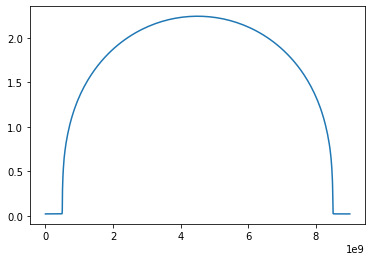

In [84]:
plt.plot(p.coordinate, p.electron_temperature.to(u.MK))

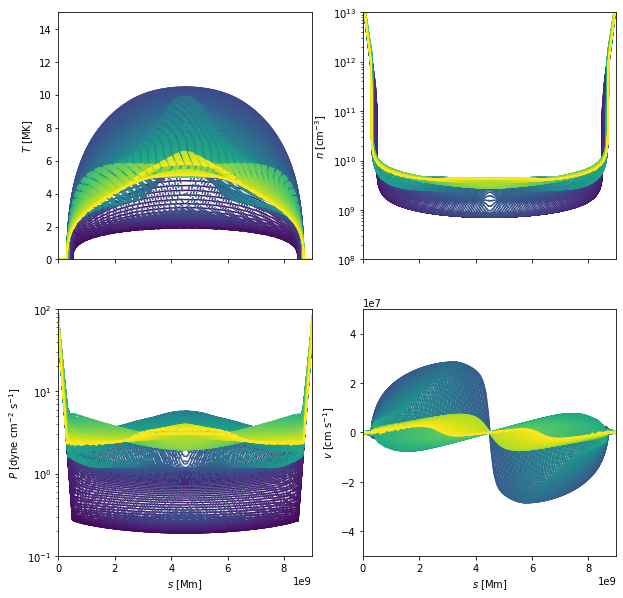

In [85]:
s.peek(start=0,step=2,stop=500)

In [86]:
Te_avg = u.Quantity([p.spatial_average('electron_temperature',bounds=(30,60)*u.Mm) for p in s[::5]])

In [87]:
Ti_avg = u.Quantity([p.spatial_average('ion_temperature',bounds=(30,60)*u.Mm) for p in s[::5]])

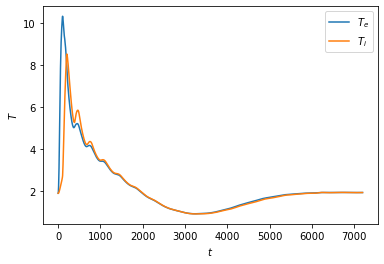

In [88]:
plt.plot(s[::5].time, Te_avg.to(u.MK),label='$T_e$')
plt.plot(s[::5].time, Ti_avg.to(u.MK),label='$T_i$')
plt.xlabel('$t$')
plt.ylabel('$T$')
plt.legend()

In [89]:
from hydrad_tools.visualize import animate_strand

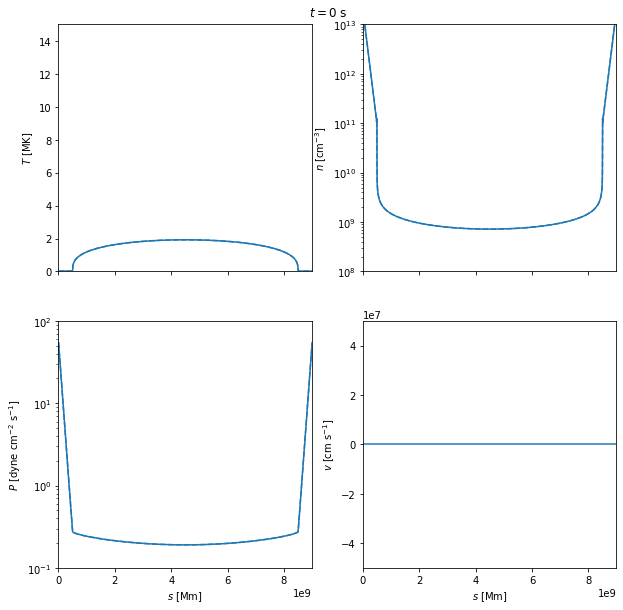

In [90]:
ani = animate_strand(s, start=0, stop=5000, step=10,)

In [60]:
HTML(ani.to_jshtml(fps=500))

Animation size has reached 20996697 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# Some Forward Modeling Results

![alt text](forward_modeling.png)

In [55]:
Video('/Users/willbarnes/Downloads/hi_c_movie_aia_res(1).mp4',embed=True,height=500)

# Questions for Discussion

* Does anyone actually want this? Are we happy with current tooling? (totally fine!)
* Agree on common functionality
* Overlap between radynpy and hydrad_tools?
* Discuss an ideal interface
* Maybe a more generalized object-oriented interface to data?